## Altcoins Analysis


In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import urllib
import requests
import riskfolio as rp
from datetime import datetime, timedelta
from copy import deepcopy

from highcharts import Highchart
from chart_builder import plot_chart, CHART_DEFAULTS
from IPython.display import display, HTML, display_html
import import_ipynb

from backend.utils import pickle_it, jformat

# Chart libraries + settings
# plt.style.use('seaborn-whitegrid')
pd.options.mode.chained_assignment = None  # default='warn' - disable some pandas warnings
pd.options.display.float_format = '{:,.2f}'.format


### Chart Template

In [2]:
%%capture
# MatPlotLib settings
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from cycler import cycler

# Swan Colors
swan_colors = ['#31597F', '#7B96B0', '#C3D9E9', '#DAE1E8']
mpl.rcParams['lines.color'] = '#31597F'
mpl.rcParams['text.color'] = '#31597F'
mpl.rcParams['axes.prop_cycle'] = cycler(color=swan_colors)
mpl.rcParams['lines.linewidth'] = 1
sns.set_style('darkgrid') # darkgrid, white grid, dark, white and ticks
plt.rcParams["figure.figsize"] = (10,5)
plt.rc('axes', titlesize=12)
plt.rc('axes', labelsize=10)   
plt.rc('xtick', labelsize=10, color='#00305E')  
plt.rc('ytick', labelsize=10, color='#00305E')    
plt.rc('legend', fontsize=12)
plt.rc('font', size=8)          

import matplotlib.ticker as ticker

# Define the formatter
formatter = ticker.StrMethodFormatter('{x:,.0f}')

from PIL import Image
fig, ax = plt.subplots()
img = Image.open('swan.jpg')
width, height = ax.figure.get_size_inches()*fig.dpi
wm_width = int(width / 2) 
scaling = (wm_width / float(img.size[0]))
wm_height = int(float(img.size[1])*float(scaling))
img = img.resize((wm_width, wm_height), Image.ANTIALIAS)

def add_watermark(ax, img):
    ax.imshow(img, aspect='equal', zorder=1, alpha=0.2, extent=(0.3, 1.6, 0.05, 0.3), transform=ax.transAxes)
    


## Toxic Handling of Shitcoins ahead 
### ⚠️ Please wear gloves and a mask

In [15]:
altlist = pickle_it('load', 'altcoins.pkl')
alt_df = pd.DataFrame(altlist['Data']).T
alt_symbols = alt_df['Symbol'].to_list()

In [16]:
alt_symbols

['42',
 '300',
 '365',
 '404',
 '433',
 '611',
 '808',
 '888',
 '1337',
 '1717',
 '2015',
 'BTCD',
 'CRAIG',
 'XBS',
 'XPY',
 'PRC',
 'YBC',
 'DANK',
 'GIVE',
 'KOBO',
 'DT',
 'CETI',
 'SUP',
 'XPD',
 'GEO',
 'CHASH',
 'NXTI',
 'WOLF',
 'XDP',
 'AC',
 'ACOIN',
 'AERO',
 'ALF',
 'AEGIS',
 'AMERICANCOIN',
 'ALIEN',
 'ARCH',
 'AURORAC',
 'AXR',
 'BETACOIN',
 'BEAN',
 'BLU',
 'BOST',
 'BQC',
 'MOONC',
 'ZET',
 'SXC',
 'QTL',
 'ENRG',
 'QRK',
 'RIC',
 'DGC',
 'LIMX',
 'BTB',
 'CAIX',
 'BTMK',
 'BUK',
 'CACH',
 'CANN',
 'CAP',
 'CASH',
 'CATC',
 'CCN',
 'CINNI',
 'CXC',
 'CLAM',
 'CLR',
 'CMC',
 'CNC',
 'CNL',
 'COMM',
 'COOL',
 'CRACK',
 'CRYPT',
 'CSC',
 'DEM',
 'DIAM',
 'DRKC',
 'DSB',
 'DEVCOIN',
 'EFL',
 'ELC',
 'EMD',
 'EXCL',
 'EXE',
 'EZC',
 'FLAP',
 'FC2',
 'FFC',
 'FIBRE',
 'FRC',
 'FLT',
 'FRK',
 'FRAC',
 'FSTC',
 'GLOBAL',
 'GLX',
 'GLYPH',
 'GML',
 'GUE',
 'HAL',
 'HBN',
 'HUC',
 'HVC',
 'HYP',
 'ICB',
 'IFC',
 'IXC',
 'JBS',
 'JKC',
 'JUDGE',
 'KDC',
 'KEYC',
 'LK7',
 'LKY',
 '

In [35]:
symbol = 'btc'
df = pickle_it('load', symbol.upper() + '_USD.price')
meta = pickle_it('load', symbol.upper() + '_USD.meta')

In [117]:
# Load all the data
assets_data = {}
for ticker in alt_symbols:
    assets_data[ticker] = pickle_it('load', ticker.upper() + '_USD.price')

In [130]:
assets_data['BTC']

,close,open,high,low,source,url,fx_close,close_converted
date,,,,,,,,
2010-07-17,0.05,0.05,0.05,0.05,cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,0.05
2010-07-18,0.09,0.05,0.09,0.06,cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,0.09
2010-07-19,0.08,0.09,0.09,0.08,cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,0.08
2010-07-20,0.07,0.08,0.08,0.07,cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,0.07
2010-07-21,0.08,0.07,0.08,0.07,cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,0.08
...,...,...,...,...,...,...,...,...
2023-03-24,"27,491.73","28,345.69","28,417.00","27,047.96",cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,"27,491.73"
2023-03-25,"27,493.43","27,491.73","27,810.74","27,188.56",cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,"27,493.43"
2023-03-26,"27,996.81","27,493.43","28,212.64","27,447.43",cryptocompare,https://min-api.cryptocompare.com/data/v2/hist...,1,"27,996.81"


In [178]:
ticker = 'BTC'
import math
start_date = pd.to_datetime('2022-01-01', format='%Y-%m-%d')
perf_mean = []
df = assets_data[ticker]
df = df.loc[df.index >= start_date]
# Normalize prices
df['norm_close'] = df['close'] / df['close'].iloc[0] 
df_resampled = df.resample("W").mean(numeric_only=True)
mean_btc = (df_resampled['norm_close'].mean())
std_dev_btc = np.std(df_resampled['norm_close'])
fig = make_subplots()

# Calculate the 95% confidence interval
ci_lower, ci_upper = stats.norm.interval(0.9, loc=mean_btc, scale=std_dev_btc)
print (ci_lower, ci_upper)

0.2429960429840633 0.9026419476375722


64.07357312380469

In [247]:
import numpy as np
import scipy.stats as stats

exclude_list = ['NAS', 'BOLI', 'BIFI', 'ELTCOIN', 'ECASH', 
                'HMP', 'OPT', 'ELE', 'IETH', 'BLINK']
start_date = pd.to_datetime('2016-01-01', format='%Y-%m-%d')
end_date = pd.to_datetime('2023-03-20', format='%Y-%m-%d')

def plot_normalized_prices(assets_data, resample_freq='M', ci_threshold=0.5):
    ticker = 'BTC'
    import math
    perf_mean = []
    df = assets_data[ticker]
    df = df.loc[df.index >= start_date]
    df = df.loc[df.index <= end_date]
    # Normalize prices
    df['norm_close'] = df['close'] / df['close'].iloc[0] 
    df_resampled = df.resample(resample_freq).mean(numeric_only=True)
    mean_btc = (df_resampled['norm_close'].mean())
    std_dev_btc = np.std(df_resampled['norm_close'])
    fig = make_subplots()
    fig.add_trace(go.Scatter(x=df_resampled.index, y=df_resampled['norm_close'], name="BTC", line=dict(color='orange', width=7), opacity=0.9))
    btc_min, btc_max = df_resampled['norm_close'].min(), df_resampled['norm_close'].max()
    
    # Calculate the 95% confidence interval
    ci_lower, ci_upper = stats.norm.interval(ci_threshold, loc=mean_btc, scale=std_dev_btc)
    count = 0
    
    btc_end_value = df['norm_close'][-1]
    outperform_count = 0
    underperform_count = 0
    empty_count = 0
    outperform_list = []
    underperform_list = []

    for asset, df in assets_data.items():
        if asset in exclude_list: continue
        if df.empty: 
            empty_count += 1
            continue
        # Remove very recent coins
        # assets with low prices are removed (a lot of vol and manipulations possible)
        df = df.loc[df.index >= start_date]
        df = df.loc[df.index <= end_date]
        if len(df.index) < 500: continue
        
        # Normalize prices
        try:
            df['norm_close'] = df['close'] / df['close'].iloc[0] 
            
        except IndexError:
            continue
        
        # Resample data to reduce the number of data points
        df_resampled = df.resample(resample_freq).mean(numeric_only=True)
    
        asset_mean_perf = df_resampled['norm_close'].mean(numeric_only=True)
        if ci_lower <= asset_mean_perf <= ci_upper:
            
            if df['norm_close'][-1] > btc_end_value:
                outperform_count += 1
                outperform_list.append(df['norm_close'][-1])
            else:
                underperform_count += 1
                underperform_list.append(df['norm_close'][-1])
            
            count += 1
            
            if asset=='ETH':
                fig.add_trace(go.Scatter(x=df_resampled.index, y=df_resampled['norm_close'], name=asset, line=dict(color='blue', width=4), opacity=0.7))
            elif asset !='BTC':
                fig.add_trace(go.Scatter(x=df_resampled.index, y=df_resampled['norm_close'], name=asset, line=dict(width=0.5), opacity=0.5))
                
    avg_out = np.mean(outperform_list) / btc_end_value
    avg_und = np.mean(underperform_list) / btc_end_value

    # Add labels for outperforming and underperforming assets
    annotations = [
        go.layout.Annotation(
        x=end_date - pd.DateOffset(months=30),
        y=btc_end_value + 30,
        xanchor='right',
        yanchor='bottom',
        text=f'Number of assets that outperformed BTC: {jformat(outperform_count,0) }<br>Avg outperformance = {jformat(avg_out, 2)}x BTC performance',
        font=dict(size=16),
        showarrow=False
    ),
        go.layout.Annotation(
        x=end_date - pd.DateOffset(months=30),
        y=btc_end_value - 0,
        xanchor='right',
        yanchor='top',
        text=f'Number of assets that underperformed BTC: {jformat(underperform_count, 0)} <br>Avg underperformance = {jformat(avg_und, 2)}x BTC performance',
        font=dict(size=16),
        showarrow=False
    ),
        go.layout.Annotation(
        x=end_date - pd.DateOffset(months=30),
        y=btc_end_value - 20,
        xanchor='right',
        yanchor='top',
        text=f'Number of assets that have no price data<br>available for period (most are dead): {jformat(empty_count, 0)}',
        font=dict(size=16),
        showarrow=False
    )
]
    
    # Add the watermark image
    watermark = go.layout.Image(
        source="swan.png",  # Path to the image file
        xref="paper",
        yref="paper",
        x=0.5,
        y=0.5,
        sizex=1,
        sizey=1,
        xanchor="center",
        yanchor="middle",
        opacity=0.1,  # Adjust opacity for watermark visibility
        layer="below",
    )

    all_assets_count = underperform_count + empty_count + outperform_count
    
    fig.update_layout(
        title=f'Normalized Asset Performance (excluding outliers)<br>Total of {jformat(all_assets_count, 0)} assets from {start_date.strftime("%d/%m/%Y")} to {end_date.strftime("%d/%m/%Y")}',
        xaxis_title='Date',
        yaxis_title='Normalized Price',
        yaxis=dict(range=[btc_min * 0.98, btc_max * 1.02]),
        showlegend=False,
        height=800,
        annotations=annotations,
        images=[watermark]
    )
    
    fig.show()



plot_normalized_prices(assets_data, resample_freq='W', ci_threshold=0.85)


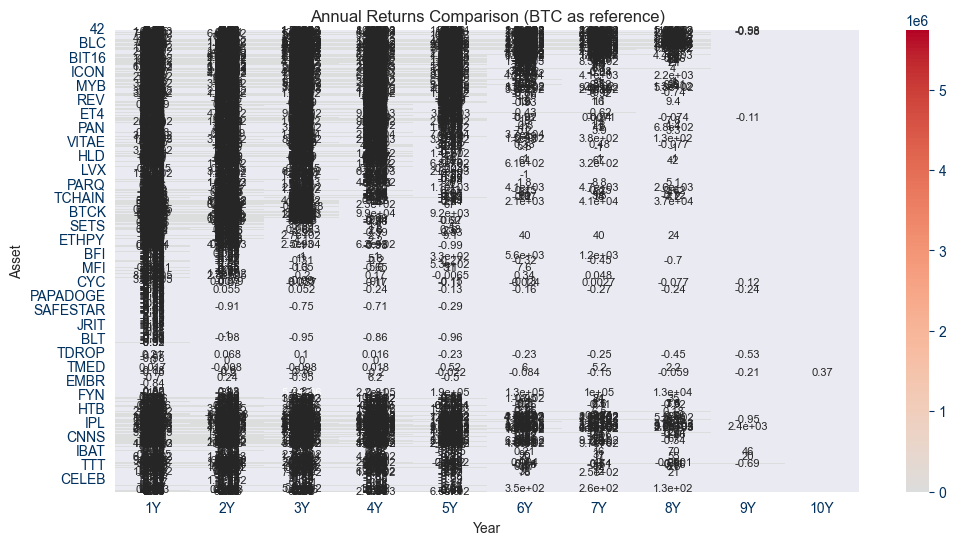

BTC returns: [264.8048879014341, 176.74187032922643, 1988.4970712987276, 12654.625126237124, 5646.7479297111695, 13659.47263179156, 45108.87679256716, 147983.2456069481, 195841.2540900828, 184947.29327408606]


In [113]:
def get_annual_returns(df, years):
    annual_returns = []
    if not df.empty:
        for year in years:
            year_end = df.index[0] + pd.DateOffset(years=year)
            if year_end in df.index:
                annual_returns.append((df.loc[year_end, 'norm_close'] - 100) / 100)
            else:
                annual_returns.append(None)
    else:
        annual_returns = [None] * len(years)
    return annual_returns

years = list(range(1, 11))  # Define the range of years for comparison
returns_data = []

for asset, df in assets_data.items():
    annual_returns = get_annual_returns(df, years)
    returns_data.append([asset] + annual_returns)

returns_df = pd.DataFrame(returns_data, columns=['Asset'] + [f'{y}Y' for y in years])
returns_df = returns_df.set_index('Asset')

btc_usd_returns = returns_df.loc['BTC']
returns_df = returns_df.drop('BTC')

plt.figure(figsize=(12, 6))
sns.heatmap(returns_df, annot=True, cmap='coolwarm', center=0
plt.title('Annual Returns Comparison (BTC as reference)')
plt.xlabel('Year')
plt.ylabel('Asset')
plt.show()

print(f'BTC returns: {btc_usd_returns.tolist()}')


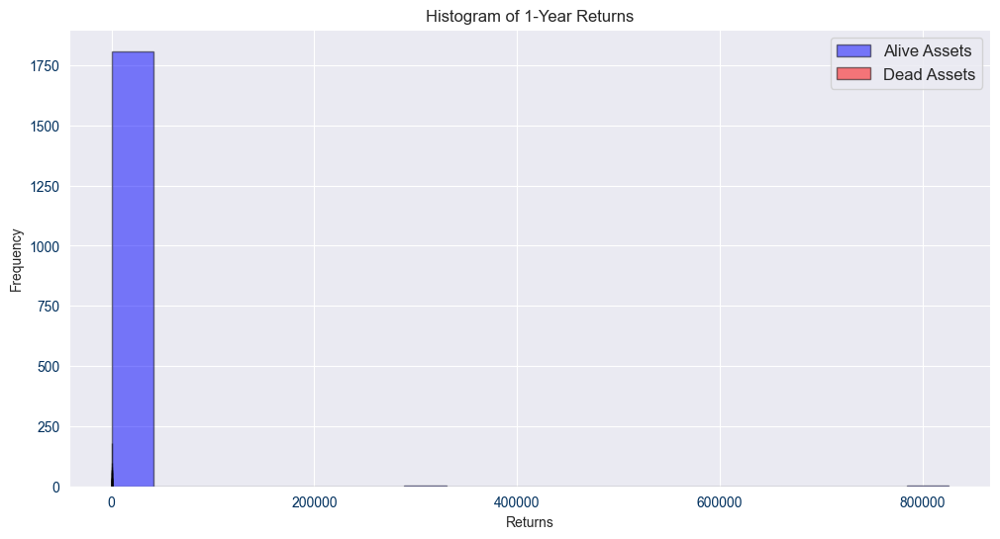

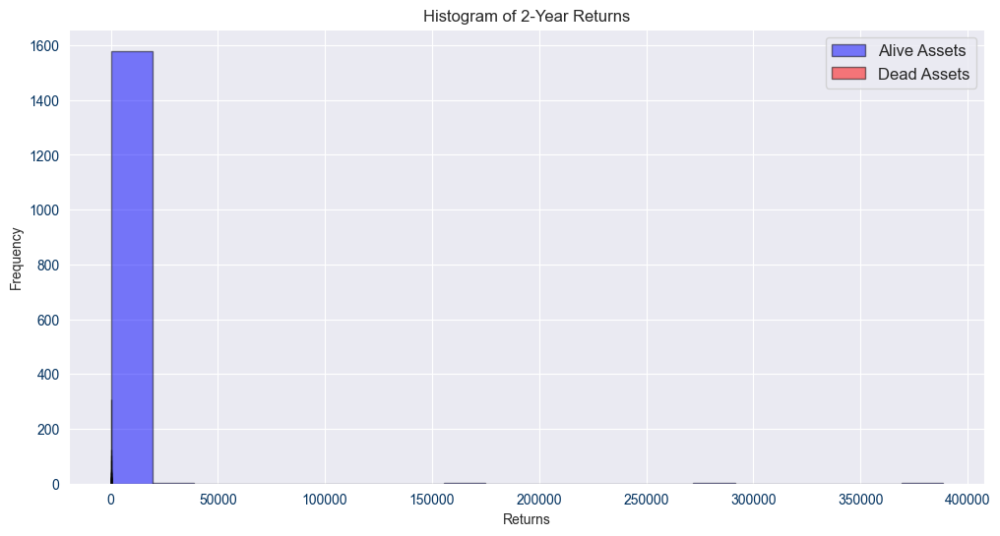

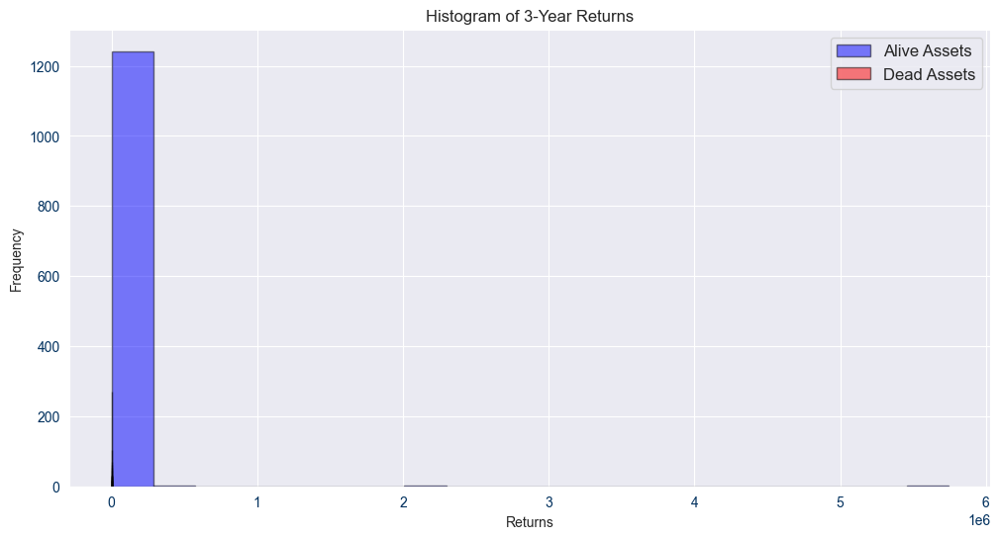

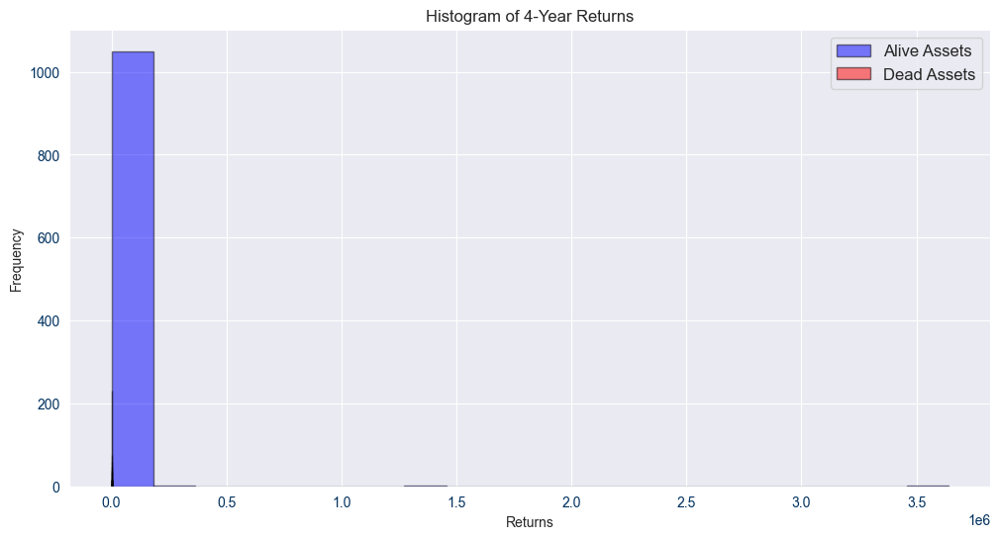

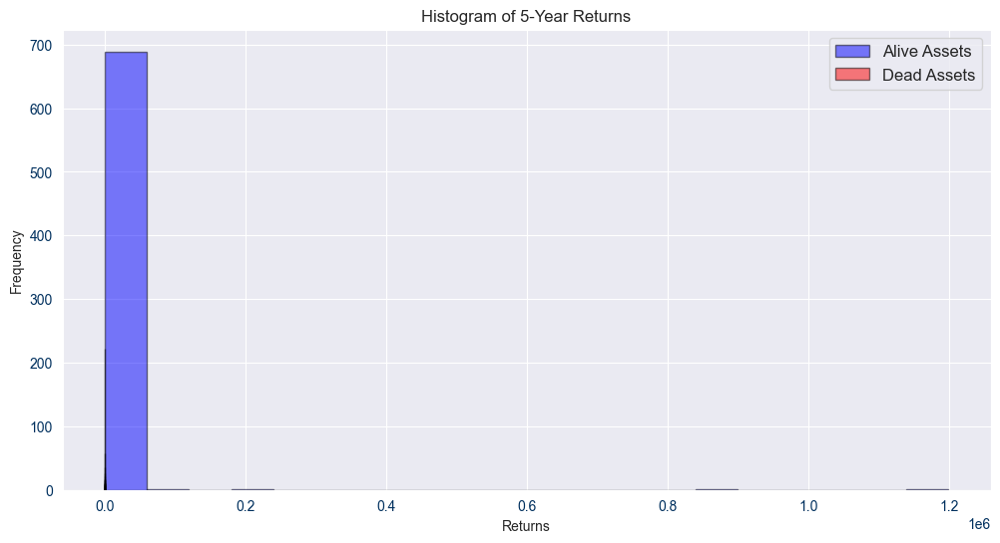

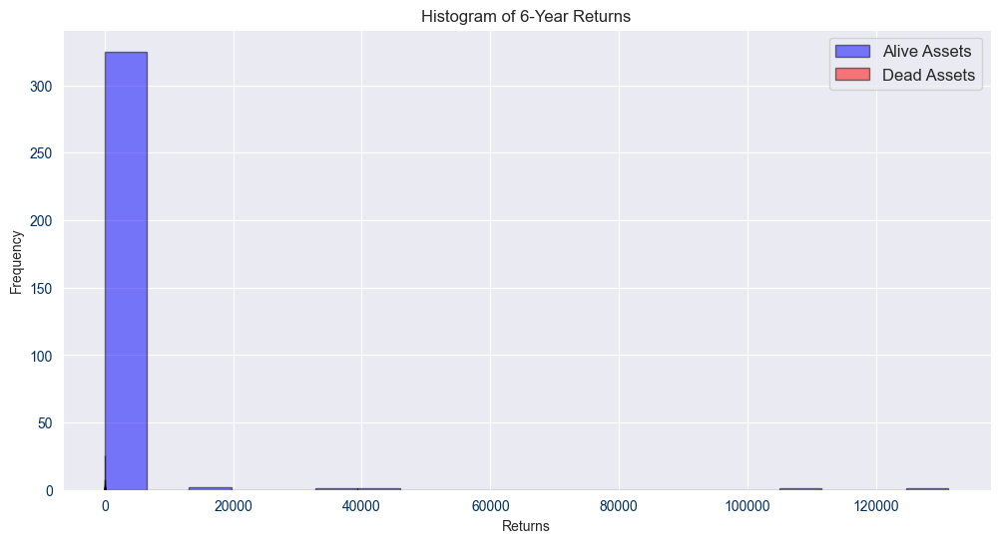

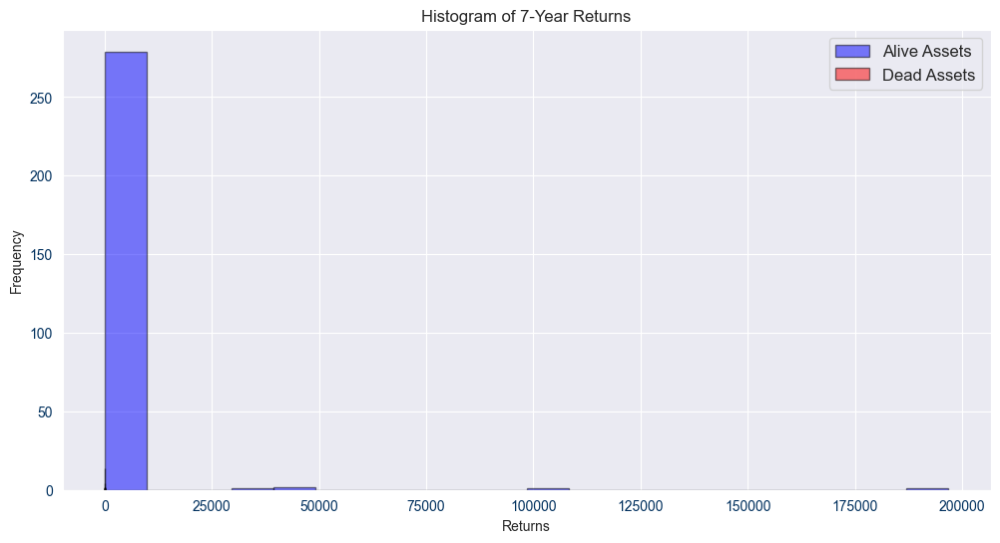

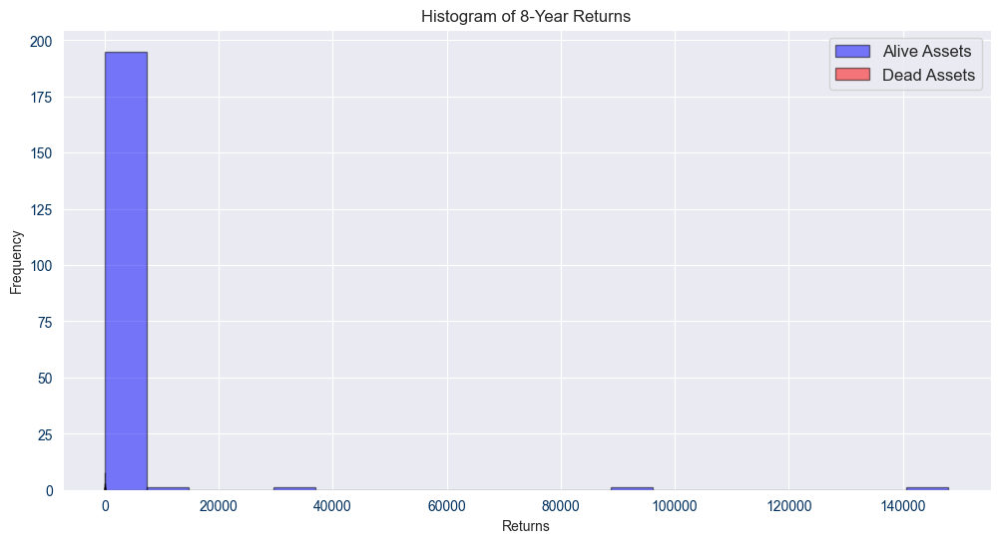

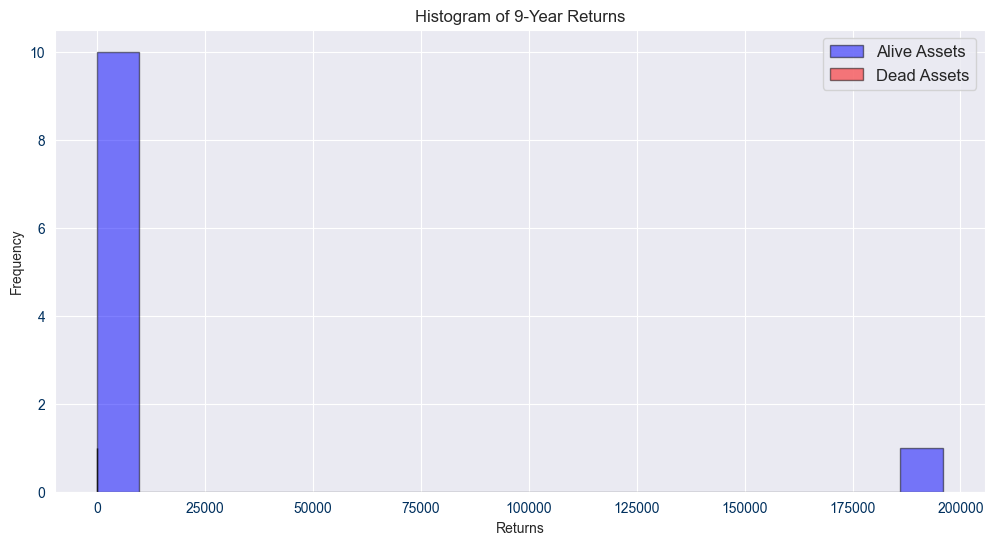

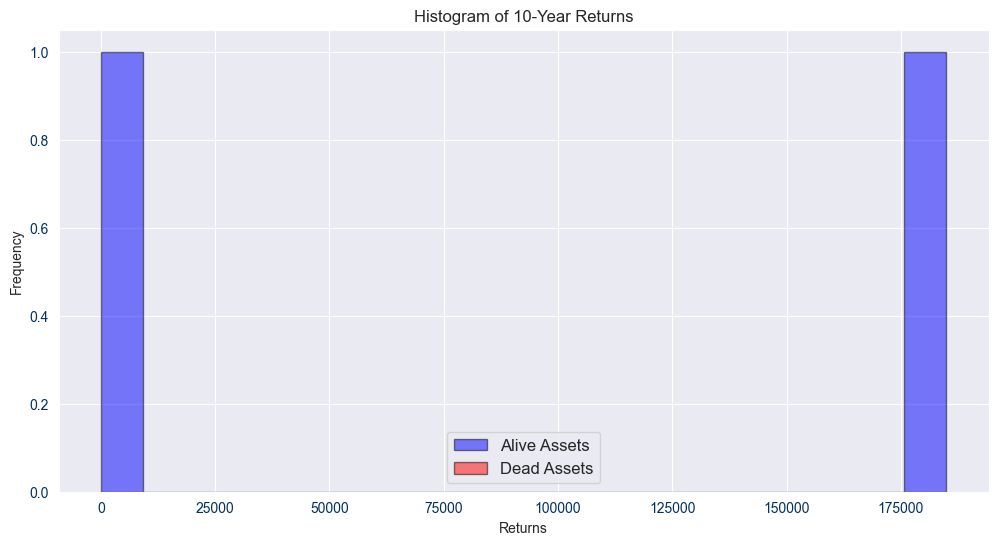

In [115]:
def plot_histogram(year, years, assets_data):
    returns = []
    dead_returns = []

    for asset, df in assets_data.items():
        annual_return = get_annual_returns(df, years)[year - 1]
        if annual_return is not None:
            if annual_return <= -0.8:
                dead_returns.append(annual_return)
            else:
                returns.append(annual_return)

    plt.hist(returns, bins=20, alpha=0.5, label='Alive Assets', color='blue', edgecolor='black')
    plt.hist(dead_returns, bins=20, alpha=0.5, label='Dead Assets', color='red', edgecolor='black')
    plt.title(f'Histogram of {year}-Year Returns')
    plt.xlabel('Returns')
    plt.ylabel('Frequency')
    plt.legend()
    plt.show()

# Plot histograms for 1, 2, and so on years
for year in years:
    plt.figure(figsize=(12, 6))
    plot_histogram(year, years, assets_data)


In [116]:
import plotly.graph_objects as go

# Calculate the count of assets for each category
def get_asset_counts_by_year(assets_data, years):
    counts = {
        'less_than_0.1': [],
        '0.1_to_1.0': [],
        'greater_than_1.0': [],
        'BTC': []
    }

    for year in years:
        less_than_0_1 = 0
        between_0_1_and_1_0 = 0
        greater_than_1_0 = 0
        btc = 0

        for asset, df in assets_data.items():
            if not df.empty:
                year_end = df.index[0] + pd.DateOffset(years=year)
                if year_end in df.index:
                    cum_return = (df.loc[year_end, 'norm_close'] - 100) / 100
                    if asset == 'BTC_USD':
                        btc = cum_return
                    elif cum_return < 0.1:
                        less_than_0_1 += 1
                    elif 0.1 <= cum_return < 1.0:
                        between_0_1_and_1_0 += 1
                    else:
                        greater_than_1_0 += 1

        counts['less_than_0.1'].append(less_than_0_1)
        counts['0.1_to_1.0'].append(between_0_1_and_1_0)
        counts['greater_than_1.0'].append(greater_than_1_0)
        counts['BTC'].append(btc)

    return counts

# Define the years for which we want to calculate the asset counts
years = list(range(1, 6))

# Calculate the asset counts for each year
counts_by_year = get_asset_counts_by_year(assets_data, years)

# Create the bar chart
fig = go.Figure(data=[
    go.Bar(name='< 0.1', x=years, y=counts_by_year['less_than_0.1']),
    go.Bar(name='0.1 to 1.0', x=years, y=counts_by_year['0.1_to_1.0']),
    go.Bar(name='> 1.0', x=years, y=counts_by_year['greater_than_1.0']),
    go.Bar(name='BTC', x=years, y=counts_by_year['BTC'])
])

# Change the bar mode
fig.update_layout(
    barmode='group',
    title='Asset Counts by Cumulative Normalized Returns',
    xaxis_title='Years',
    yaxis_title='Asset Counts / Cumulative Normalized Returns'
)

fig.show()
